# <u style="color:red"> SPOTIFY DATA ANALYSIS </u> 

this anaysis will be based on the popularity and the different features that could have a (positive/negative) influence on it
we try to answer some questions like: <br> how the popularity of the songs change with years ? <br>how could we make a popular song ?<br>what kindof music people liked to hear in a ceratin period ?<br> and more other questions ...

# <u> Description of the data</u><br>
<table>
  <tr >
      <td style="text-align: left;"><b>feature</b></td>
    <td style="text-align: left;"><b>description</b></td>
  </tr>
  <tr>
    <td style="text-align: left;"><b>Genre</b></td>
    <td style="text-align: left;">the genre of the track</td>
  </tr>
  <tr>
    <td style="text-align: left;"><b>Year</b></td>
    <td style="text-align: left;">the release year of the recording.</td>
  </tr>
  <tr>
    <td style="text-align: left;"><b>Energy</b></td>
    <td style="text-align: left;">The energy of a song - the higher the value, the more energtic. song</td>
  </tr>
  <tr>
    <td style="text-align: left;"><b>Danceability</b></td>
    <td style="text-align: left;">The higher the value, the easier it is to dance to this song.</td>
  </tr>
  <tr>
    <td style="text-align: left;"><b>Loudness</b></td>
    <td style="text-align: left;">The higher the value, the louder the song.</td>
  </tr>
  <tr>
    <td style="text-align: left;"><b>Liveness</b></td>
    <td style="text-align: left;">The higher the value, the more likely the song is a live recording.</td>
  </tr>
  <tr>
    <td style="text-align: left;"><b>Valence</b></td>
    <td style="text-align: left;">The higher the value, the more positive mood for the song.</td>
  </tr>
  <tr>
    <td style="text-align: left;"><b>duration</b></td>
    <td style="text-align: left;">The length of the song</td>
  </tr>
  <tr>
    <td style="text-align: left;"><b>Acousticness</b></td>
    <td style="text-align: left;">The higher the value the more acoustic the song is.</td>
  </tr>
  <tr>
    <td style="text-align: left;"><b>Speechiness</b></td>
    <td style="text-align: left;">The higher the value the more spoken word the song contains.</td>
  </tr>
  <tr>
    <td style="text-align: left;"><b>Popularity</b></td>
    <td style="text-align: left;">The higher the value the more popular the song is.</td>
  </tr>
  <tr>
    <td style="text-align: left;"><b>artists</b></td>
    <td style="text-align: left;">the name(s) of the artist(s) that made the song.</td>
  </tr>
  <tr>
    <td style="text-align: left;"><b>tempo</b></td>
    <td style="text-align: left;">tempo is the speed or pace of a given piece and derives directly from the average beat duration.</td>
  </tr>
  <tr>
      <td style="text-align: left;"><b>release_date</b></td>
    <td style="text-align: left;">the day/moth/year of the release of the song</td>
  </tr>  
  <tr>
    <td style="text-align: left;"><b>instrumentalness</b> </td>
    <td style="text-align: left;">The closer the instrumentalness value is to 1.0, the greater likelihood the track contains no vocal content.</td>
  </tr>
    
</table>


## Table of Contents
* [importing and understanding the data](#chapter1)
* [cleaning the data](#chapter2)
* [Exploring and visualizing the data:](#chapter3)
    * [What attributes make a song popular in general?](#section_3_1)
* [Feature engineering](#chapter4)
    * [what should we do to make a hit ?](#section_4_1)
    * [Does this "hitfactor" control absolutly the popularity ? ](#section_4_2)
    * [How does the hitfactor level increase and decrease over time?](#section_4_3)
* [Analysis](#chapter5)
    * [HYPOTHESIS 1](#section_5_1)
    * [CONCLUSION 1](#section_5_2)
    * [HYPOTHESIS 2](#section_5_3)
    * [Training a classifier on "genre"](#section_5_4)
        * [correlations of the newdata frame features](#sub_section_5_4_1)
        * [PCA for dimentionnality reduction](#sub_section_5_4_2)
        * [train the model](#sub_section_5_4_3)
        * [apply the model on the original data to add gennre column](#sub_section_5_4_4)
    * [understanding the "genre" column](#section_5_5)
        * [clustering and visualising the data by PCA](#sub_section_5_5_1)
        * [linear regression between year and popularity](#sub_section_5_5_2)
    * [what caracteristics have every genre](#section_5_6)
    * [what "genre" was popular in the thirties](#section_5_7)
    * [CONCLUSION 2](#section_5_8)
* [MORE MEANINGFUL PLOTS AND INFORMATION](#chapter5)
    * [How many song there is for every genre](#section_6_1)
    * [popularity of every genre](#section_6_2)    

In [35]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import plotly
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
from sklearn import datasets, linear_model
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn import neighbors
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score
from sklearn.pipeline import Pipeline
from sklearn.cluster import KMeans
from sklearn.linear_model import LinearRegression
import warnings

warnings.filterwarnings('ignore')

# <span id =1> importing and understanding the data </span>  <a class="anchor" id="chapter1"></a>

In [2]:
data_frame = pd.read_csv("./spotify_data.csv")

In [3]:
data_frame.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 169909 entries, 0 to 169908
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   acousticness      169909 non-null  float64
 1   artists           169909 non-null  object 
 2   danceability      169909 non-null  float64
 3   duration_ms       169909 non-null  int64  
 4   energy            169909 non-null  float64
 5   explicit          169909 non-null  int64  
 6   id                169909 non-null  object 
 7   instrumentalness  169909 non-null  float64
 8   key               169909 non-null  int64  
 9   liveness          169909 non-null  float64
 10  loudness          169909 non-null  float64
 11  mode              169909 non-null  int64  
 12  name              169909 non-null  object 
 13  popularity        169909 non-null  int64  
 14  release_date      169909 non-null  object 
 15  speechiness       169909 non-null  float64
 16  tempo             16

# cleaning the data <a class="anchor" id="chapter2"></a>
Data clean up plan:
<ol>
    <li>Change name data type => string
    <li>Change Artist data type => string
    <li>Change release_date data type => datetime 
    <li>Change id data type => string
    <li>Change duration_ms to duation (in seconds)
    <li>sort the data by populatoin to make it more easy to manupilate (because wwe're studying the population)
    <li>Change the order of the columns (for trainning purpose)
</ol>

In [4]:
data_frame.isnull().sum()

acousticness        0
artists             0
danceability        0
duration_ms         0
energy              0
explicit            0
id                  0
instrumentalness    0
key                 0
liveness            0
loudness            0
mode                0
name                0
popularity          0
release_date        0
speechiness         0
tempo               0
valence             0
year                0
dtype: int64

as we can see the data is numerical in general and there is no missing data 
so we don't have to do anything else to clean it more (generally we could make some mean or knn imputation to fill the missing information)

In [5]:
# sort the data in the descending prder acoording to the population values
data = data_frame.sort_values('popularity',ascending=False).reset_index()

#convert the (ms) to (s) and dropping the old column
data['duration'] = data['duration_ms'].apply(lambda x:round(x/1000))
data.drop('duration_ms', inplace=True,axis=1)

# we reset the indices (for beauty)
data.drop('index', inplace=True,axis=1)

# changing data types
data['name'] = data['name'].astype('string')
data['artists'] = data['artists'].astype('string')
data['id'] = data['id'].astype('string')
data.release_date = pd.to_datetime(data.release_date)

#change the order of the columns 
data = data_frame[['acousticness', 'danceability', 'duration_ms', 'energy',
           'instrumentalness', 'key', 'liveness', 'loudness', 'mode',
           'speechiness', 'tempo', 'valence','popularity','year']]
#showing the knew cleaned data 
data

,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,valence,popularity,year
0,0.9950,0.708,158648,0.1950,0.563000,10,0.1510,-12.428,1,0.0506,118.469,0.7790,0,1928
1,0.9940,0.379,282133,0.0135,0.901000,8,0.0763,-28.454,1,0.0462,83.972,0.0767,0,1928
2,0.6040,0.749,104300,0.2200,0.000000,5,0.1190,-19.924,0,0.9290,107.177,0.8800,0,1928
3,0.9950,0.781,180760,0.1300,0.887000,1,0.1110,-14.734,0,0.0926,108.003,0.7200,0,1928
4,0.9900,0.210,687733,0.2040,0.908000,11,0.0980,-16.829,1,0.0424,62.149,0.0693,1,1928
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
169904,0.1730,0.875,163800,0.4430,0.000032,1,0.0891,-7.461,1,0.1430,100.012,0.3060,75,2020
169905,0.0167,0.719,167468,0.3850,0.031300,8,0.1110,-10.907,1,0.0403,128.000,0.2700,64,2020
169906,0.5380,0.514,180700,0.5390,0.002330,7,0.1080,-9.332,1,0.1050,123.700,0.1530,70,2020
169907,0.0714,0.646,167308,0.7610,0.000000,1,0.2220,-2.557,1,0.0385,129.916,0.4720,70,2020


# Exploring and visualizing the data: <a class="anchor" id="chapter3"></a>
Data exploring plan:
<ol>
    <li> finding some meaningfull statistics about the featers (means/var/corrcoefs/...)
    <li> spot the relevant features for the popularity (with correlation matrix)
    <li> make some plots to see the attitude of these features and how they could affect the popularity
    <li> feature engineering to simulate more precisely the behavior of the popularity
    <li> find out why popularity could change with time 
</ol>

In [6]:
# some stats about the data
stats = data.describe().transpose()
stats

,count,mean,std,min,25%,50%,75%,max
acousticness,169909.0,0.493214,0.376627,0.0,0.0945,0.492000,0.8880,0.996
danceability,169909.0,0.538150,0.175346,0.0,0.4170,0.548000,0.6670,0.988
duration_ms,169909.0,231406.158973,121321.923219,5108.0,171040.0000,208600.000000,262960.0000,5403500.000
energy,169909.0,0.488593,0.267390,0.0,0.2630,0.481000,0.7100,1.000
instrumentalness,169909.0,0.161937,0.309329,0.0,0.0000,0.000204,0.0868,1.000
key,169909.0,5.200519,3.515257,0.0,2.0000,5.000000,8.0000,11.000
liveness,169909.0,0.206690,0.176796,0.0,0.0984,0.135000,0.2630,1.000
loudness,169909.0,-11.370289,5.666765,-60.0,-14.4700,-10.474000,-7.1180,3.855
mode,169909.0,0.708556,0.454429,0.0,0.0000,1.000000,1.0000,1.000
speechiness,169909.0,0.094058,0.149937,0.0,0.0349,0.045000,0.0754,0.969


[Text(0.5, 0, 'acousticness'),
 Text(1.5, 0, 'danceability'),
 Text(2.5, 0, 'duration_ms'),
 Text(3.5, 0, 'energy'),
 Text(4.5, 0, 'instrumentalness'),
 Text(5.5, 0, 'key'),
 Text(6.5, 0, 'liveness'),
 Text(7.5, 0, 'loudness'),
 Text(8.5, 0, 'mode'),
 Text(9.5, 0, 'speechiness'),
 Text(10.5, 0, 'tempo'),
 Text(11.5, 0, 'valence'),
 Text(12.5, 0, 'popularity'),
 Text(13.5, 0, 'year')]

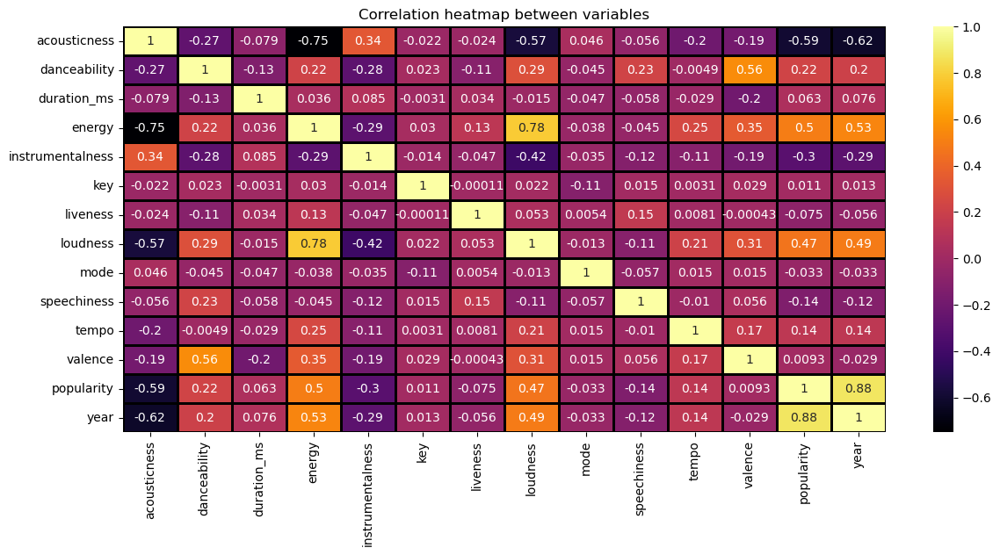

In [7]:
# show the correlation matrix between the features
corr_df = data.corr(method='pearson')
plt.figure(figsize=(14,6))
heatmap=sns.heatmap(corr_df,annot=True,cmap='inferno',linewidths=1,linecolor='black')
heatmap.set_title("Correlation heatmap between variables")
heatmap.set_xticklabels(heatmap.get_xticklabels(),rotation=90)

#### here we can see that there is a stong correlation between popularity and (year/energy/loudnes/acousticness) low correlation with the other featues

1 - we are creating a new dataset grouped by the popularity (we will have 100 Rows) with the means of all the features <br>
2 - also adding a new column called song/popularity wich indicates how many songs are having a partiular popularity

In [8]:
means = []
popularities = []
for value in data['popularity'].unique():
    popularities.append(value)
popularities = sorted(popularities)
for value in popularities:
    means.append(data[data['popularity']==value].mean()) 
popularity_data = pd.DataFrame(means)
for value in popularities:
    index = popularity_data.index[popularity_data['popularity']==value]
    popularity_data.at[index[0],'song/popularity'] = data[data['popularity']==value]['popularity'].count()

popularity_data['popularity'] = popularity_data['popularity'].astype(int)
popularity_data['song/popularity'] = popularity_data['song/popularity'].astype(int)

In [9]:
# our new data (new form of the same data)
popularity_data

,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,valence,popularity,year,song/popularity
0,0.867570,0.494920,215055.212999,0.262413,0.343883,5.182951,0.225819,-15.314667,0.701649,0.177562,108.203914,0.511625,0,1941.726395,27357
1,0.881397,0.478286,222636.221828,0.273544,0.321110,5.167702,0.211195,-15.228111,0.725821,0.110741,110.656896,0.476586,1,1944.860248,2254
2,0.874136,0.491528,203387.122843,0.291329,0.314944,5.209800,0.209314,-14.439143,0.717736,0.094790,110.893184,0.503946,2,1944.588682,1449
3,0.864674,0.492906,204865.135000,0.284152,0.308838,5.125833,0.210646,-14.461250,0.698333,0.087737,110.726850,0.492102,3,1945.285833,1200
4,0.871332,0.487428,206611.655493,0.273987,0.313071,5.020484,0.204773,-14.716422,0.729981,0.078281,111.942562,0.481161,4,1947.598696,1074
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,0.199650,0.816750,210934.750000,0.611250,0.000479,7.250000,0.355000,-7.173250,0.250000,0.099875,109.904000,0.656500,95,2019.250000,4
96,0.233000,0.716000,165978.000000,0.537000,0.000000,0.000000,0.157000,-7.648000,0.000000,0.051400,129.979000,0.280000,96,2020.000000,1
97,0.731000,0.726000,173333.000000,0.431000,0.000000,8.000000,0.696000,-8.765000,0.000000,0.135000,144.026000,0.348000,97,2020.000000,1
98,0.247000,0.746000,181733.000000,0.690000,0.000000,11.000000,0.101000,-7.956000,1.000000,0.164000,89.977000,0.497000,99,2020.000000,1


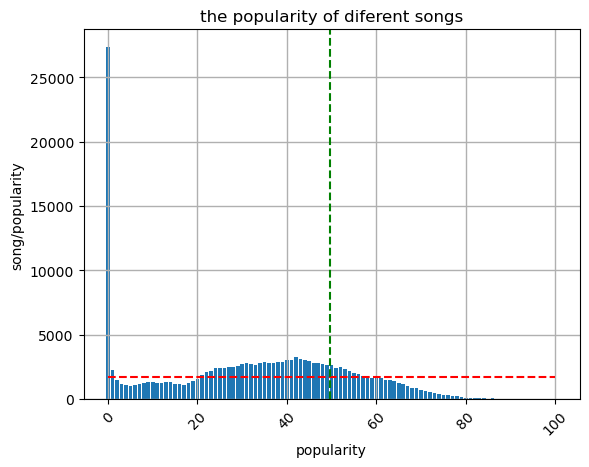

In [10]:
mean_song_pop = popularity_data['song/popularity'].mean()
mean_pop = popularity_data['popularity'].mean()

fig, ax = plt.subplots()
plt.bar(popularity_data['popularity'],popularity_data['song/popularity'])
plt.hlines(y=mean_song_pop, xmin=0, xmax=100, color='r', linestyle='--')
ax.axvline(x=mean_pop, color='g', linestyle='--')
plt.xticks(rotation=45)
plt.grid(linewidth=1)
plt.title("the popularity of diferent songs")
plt.xlabel("popularity")
plt.ylabel("song/popularity")
plt.show()

#### we can see that the extreme majority of audios are not popular  and very few are <br>
- very few songs of a big popularity (>85) 
- lot of songs with low popularity (<3)
- to make more precise interpretations we have take take a closer look to songs of (popularity >85 & popularity < 3)

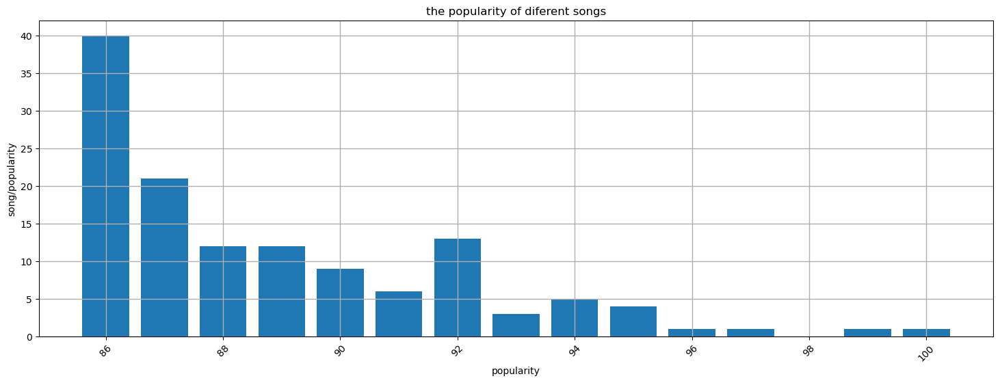

In [11]:
pop = popularity_data[popularity_data['popularity']>85]['popularity']
song_pop = popularity_data[popularity_data['popularity']>85]['song/popularity']
plt.figure(figsize=(18,6))
plt.bar(pop,song_pop)
plt.xticks(rotation=45)
plt.grid(linewidth=1)
plt.title("the popularity of diferent songs")
plt.xlabel("popularity")
plt.ylabel("song/popularity")
plt.show()

here the popularity per song don't pass the 40 (the mean is 1600) so <b>only 3%</b> of songs can make it to the top  

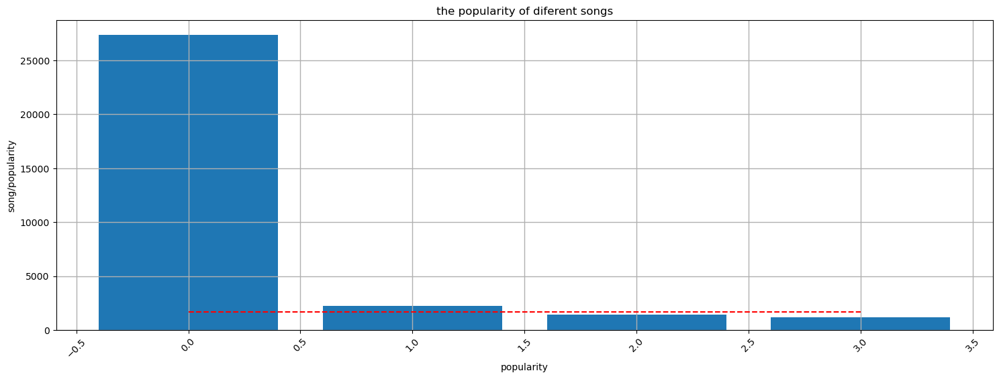

In [12]:
pop = popularity_data[popularity_data['popularity']<=3]['popularity']
song_pop = popularity_data[popularity_data['popularity']<=3]['song/popularity']
plt.figure(figsize=(18,6))
plt.bar(pop,song_pop)
plt.hlines(y=mean_song_pop, xmin=0, xmax=3, color='r', linestyle='--')
plt.xticks(rotation=45)
plt.grid(linewidth=1)
plt.title("the popularity of diferent songs")
plt.xlabel("popularity")
plt.ylabel("song/popularity")
plt.show()

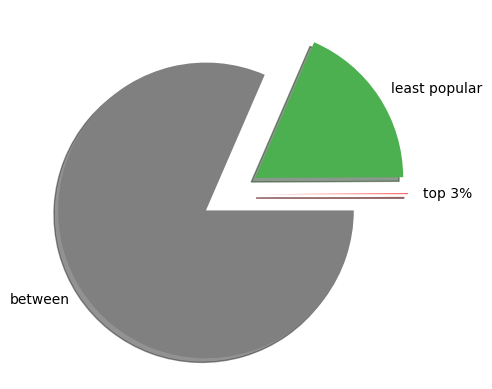

In [13]:
# we will try to plot this clealy with a pie chart
tout = float(popularity_data[popularity_data['popularity']<=100]['song/popularity'].sum())
a= float((popularity_data[popularity_data['popularity']>85]['song/popularity'].sum()) / tout)*100
b= float((popularity_data[popularity_data['popularity']<3]['song/popularity'].sum()) / tout)*100
c= float((popularity_data[popularity_data['popularity'].between(3,85,inclusive=False)]['song/popularity'].sum()) / tout)*100

y = np.array([a,b,c])
mylabels = ["top 3%", "least popular", "between"]
mycolors = ["red", "#4CAF50", "grey"]
myexplode = [0.2, 0.2, 0.2]
plt.pie(y,labels=mylabels,explode=myexplode,shadow = True,colors=mycolors)
plt.show()

## <a style="color: green" class="anchor" id="section_3_1"> What attributes make a song popular in general? </a>

as we can see there a lot of songs with popularity = 0 <br>
we will try to make a comparison between the hits and the non popular gongs to see what makes this difference<br>
based on the correlation table popularity have a strong relation with [year / loudness / energy / accousticness]<br>
so we will try to take a closer look on these features 

In [14]:
sound_features1 = ['acousticness','danceability','energy','instrumentalness']
fig = px.line(popularity_data, x='popularity', y=sound_features1)
fig.show()


we will analyse the behavior of every feater: </br>
<b>accousticness: </b>the less the value the more popular are the songs  with an exeption for the <b>(pop=95)</b></br>
<b>energy: </b>the more is the energy has the song the more popular the song with an exeption for the <b>(pop =97)</b></br>
<b>danceability:</b>the more is the danceability the more popular the song with an exeption for the <b>(pop =100)</b></br>
<b>instrumentalness </b>: the less the value the more popular are the songs with an exeption for the <b>(pop=90)</b></br>


In [15]:
fig = px.line(popularity_data, x='popularity', y='loudness')
fig.show()

<b>loudness:</b> the more is the loudness in the song the more popular the song will be with an exception for the <b>(pop =97)</b>

In [16]:
fig = px.line(popularity_data, x='popularity', y='year')
fig.show()

<b>year</b>: we can clearly see that there is a strong positive relation between year and popularity

# feature Engineering <a class="anchor" id="chapter4"></a>

## <a style="color: green" class="anchor" id="section_4_1">what should we do to make a hit ?<a>

</br>
<b> As we can see all of the previous factors have a general behavior but always there is an exeption where the factor was not good but the song was popular though </b></br>
we think that the reason of this is that when some feature is down. the other features componsate, <br>
that's why we end up with a big popularity even though a feature was not optimal)
so here we're going to make a new featurecalled <b>(hitfactor)</b>which is a combination between all of these features

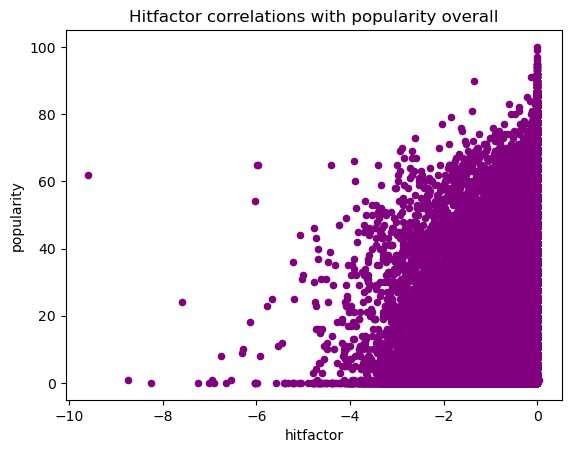

In [17]:
#making the hitfactor
data['hitfactor'] = data['energy'] * data['danceability'] * data['loudness'] * data['acousticness'] * data['instrumentalness'] 
data.plot(kind='scatter', x='hitfactor', y='popularity', color = 'purple')
plt.title('Hitfactor correlations with popularity overall');

so the question now is : <br> 
## <a style="color: green" class="anchor" id="section_4_2"> Does this "hitfactor" control absolutly the popularity ? </a>

To see this, we created a new dataframe looking at average attribute levels grouped by year, then plotted hitfactor levels over time...

In [18]:
#groupping the data by years(100 years : 1921-2021)
data_year = data.groupby('year').mean()
data_year

,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,valence,popularity,hitfactor
year,,,,,,,,,,,,,,
1921,0.895823,0.425661,229911.914062,0.236784,0.322330,5.031250,0.215814,-17.095437,0.656250,0.077258,100.397758,0.425495,0.351562,-0.334053
1922,0.939236,0.480000,167904.541667,0.237026,0.440470,5.236111,0.238647,-19.179958,0.625000,0.115419,101.376139,0.534056,0.138889,-0.559386
1923,0.976329,0.568462,178356.301775,0.246936,0.401932,4.846154,0.236656,-14.373882,0.775148,0.098619,112.456598,0.624788,5.727811,-0.818290
1924,0.935575,0.548654,188461.649789,0.347033,0.583955,5.637131,0.237875,-14.202304,0.751055,0.090210,120.653359,0.668574,0.603376,-1.378470
1925,0.965422,0.571890,184130.699620,0.264373,0.408893,5.171103,0.243094,-14.516707,0.718631,0.115457,115.671715,0.616430,2.707224,-0.813034
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016,0.280290,0.599976,219400.763840,0.592877,0.074646,5.225495,0.180198,-7.949913,0.638903,0.107298,119.070344,0.430769,61.371254,-0.041606
2017,0.289916,0.612286,209343.613000,0.586739,0.098209,5.073000,0.194218,-8.422697,0.624500,0.111752,116.840277,0.414465,64.861500,-0.076075
2018,0.271941,0.664930,200919.119000,0.590591,0.035948,5.347500,0.171781,-7.253666,0.613000,0.128140,122.004325,0.447141,67.276000,-0.025386


<AxesSubplot:xlabel='hitfactor', ylabel='popularity'>

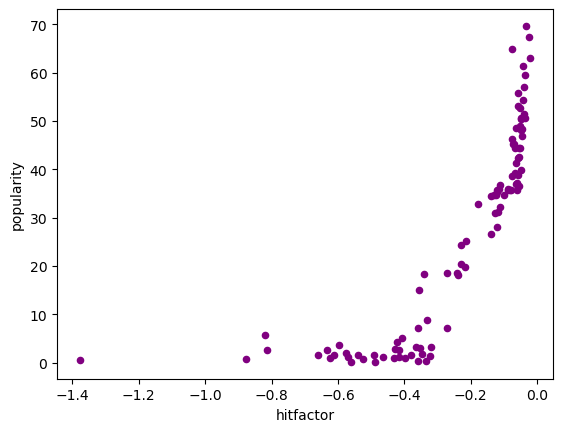

In [19]:
data_year.plot(kind='scatter', x='hitfactor', y='popularity', color = 'purple')

## <a style="color: green" class="anchor" id="section_4_3">How does the hitfactor level increase and decrease over time?</a>

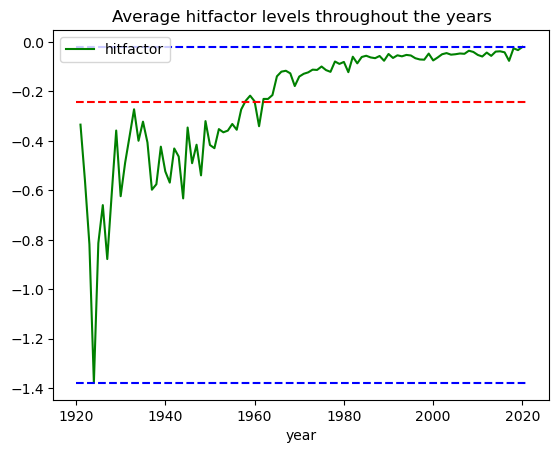

In [20]:
data_year_hitfactor_plot = data_year[['hitfactor']] 
mean = data_year['hitfactor'].mean()
maxi= data_year['hitfactor'].max()
mini = data_year['hitfactor'].min()
data_year_hitfactor_plot.plot(kind='line', color = 'green')
plt.hlines(y=mean, xmin=1920, xmax=2021, color='r', linestyle='--')
plt.hlines(y=mini, xmin=1920, xmax=2021, color='b', linestyle='--')
plt.hlines(y=maxi, xmin=1920, xmax=2021, color='b', linestyle='--')

plt.title('Average hitfactor levels throughout the years');
plt.show()

we will try to see the behavior of population with respect to the years to see if <b>(hitfactor / popularity) </b>have the same behavior

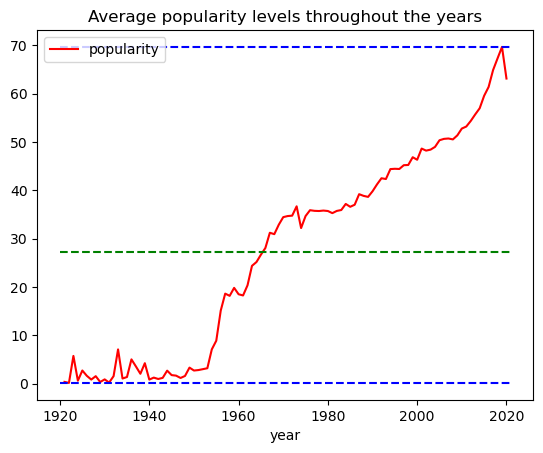

In [21]:
data_year_hitfactor_plot = data_year[['popularity']]
mean = data_year['popularity'].mean()
maxi= data_year['popularity'].max()
mini = data_year['popularity'].min()
data_year_hitfactor_plot.plot(kind='line', color = 'red')
plt.hlines(y=mean, xmin=1920, xmax=2021, color='g', linestyle='--')
plt.hlines(y=mini, xmin=1920, xmax=2021, color='b', linestyle='--')
plt.hlines(y=maxi, xmin=1920, xmax=2021, color='b', linestyle='--')

plt.title('Average popularity levels throughout the years');
plt.show()

we have closely the same behavior between <b>'popularity'</b> and <b>hitfactor</b><br>
the only difference is that the popularity is going constantly from <b>1920</b> to <b>1940</b><br>
while we have a minimal value for hitfactor in<b>[1920 - 1930]</b>


also we can see that the popularity of the songs is quite constant between [1920- 1940] While the hitfactor is having ups and downs, 
So the question now is :<b> why the poplarity did not follow the hitfactor perfectly ? <br>what are the factors that control the popularity with the hitfacto ?<br>
why does the graph of hitfactor go so much down in the 30's ?
</b>

# Analysis <a class="anchor" id="chapter5"></a>

we did see that the popularity in <b>1930</b> was nearly the same in all the decade when the hitfactor is falling down in certain year between <b>[1920-1930]</b><br>
<b>we will try to see why did the popularity hold the same even when the hitfactor goes down ?</b>

## <a style="color: green" class="anchor" id="section_5_1"> Hypothesis 1 </a>
we assume that the popularity did not go down with the hitfactor because other features were componsating the differance <br>

To see if this is true of false we will try to see the behavior of the other features <b>[speechiness / tempo /liveness / valence]</b> while the thirties (1920-1930)
<br>if their behavior is different than usual, that explain everything otherwise the hypothesis is wrong 

In [22]:
thirties_data = data_frame[(data_frame.year >1920) & (data_frame.year <1940)]
#thirties_data

<Figure size 640x480 with 0 Axes>

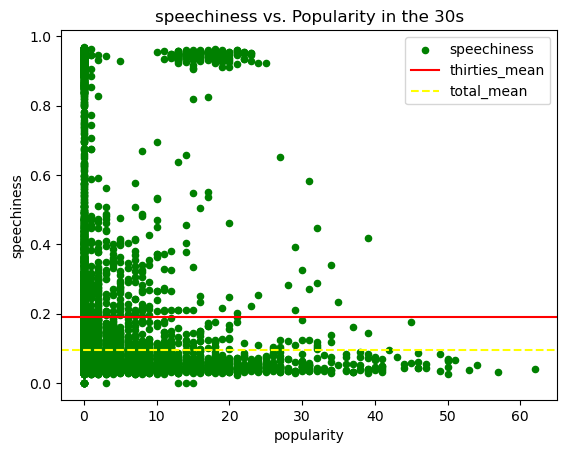

<Figure size 640x480 with 0 Axes>

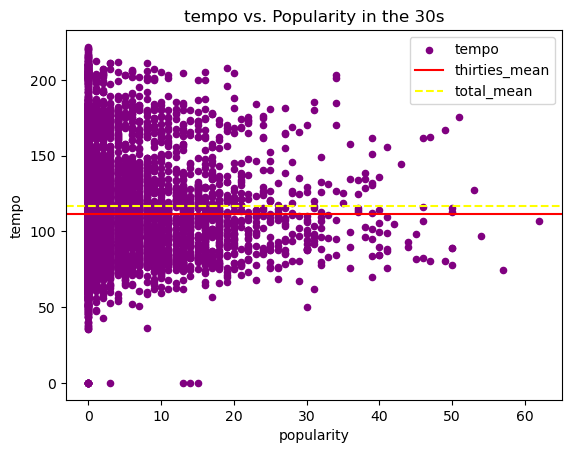

<Figure size 640x480 with 0 Axes>

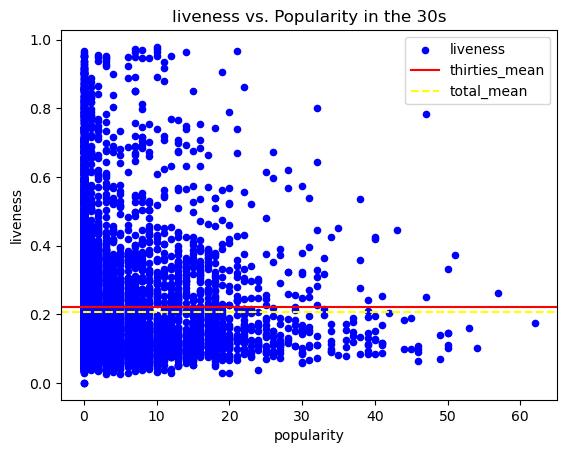

<Figure size 640x480 with 0 Axes>

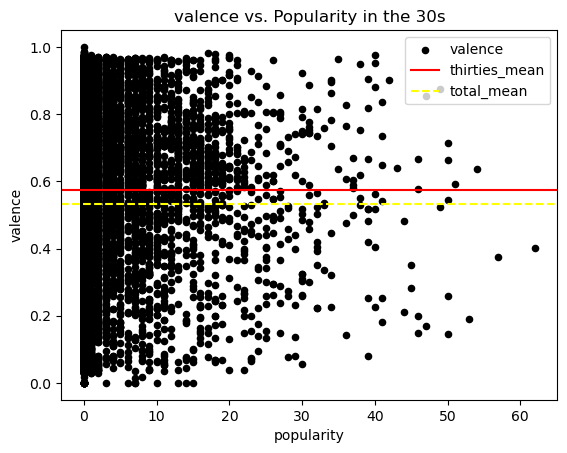

In [23]:
mean_speach = data_frame['speechiness'].mean()
mean_thirties_speach = thirties_data['speechiness'].mean()

mean_tempo = data_frame['tempo'].mean()
mean__tempo_thirties = thirties_data['tempo'].mean()

mean_liveness = data_frame['liveness'].mean()
mean_liveness_thirties = thirties_data['liveness'].mean()

mean_valence = data_frame['valence'].mean()
mean_valence_thirties = thirties_data['valence'].mean()

fig1 = plt.figure()
thirties_data.plot(kind='scatter', x='popularity', y='speechiness', color = 'green',label="speechiness")
plt.axhline(y=mean_thirties_speach, color='r',label="thirties_mean")
plt.axhline(y=mean_speach, color='yellow',linestyle='dashed',label="total_mean")
plt.title('speechiness vs. Popularity in the 30s');
plt.legend(loc = 0)

fig2 = plt.figure()
thirties_data.plot(kind='scatter', x='popularity', y='tempo', color = 'purple',label="tempo")
plt.axhline(y=mean__tempo_thirties, color='r',label="thirties_mean")
plt.axhline(y=mean_tempo, color='yellow',linestyle='dashed',label="total_mean")
plt.title('tempo vs. Popularity in the 30s');
plt.legend(loc = 0)

fig3 = plt.figure()
thirties_data.plot(kind='scatter', x='popularity', y='liveness', color = 'blue',label="liveness")
plt.axhline(y=mean_liveness_thirties, color='r',label="thirties_mean")
plt.axhline(y=mean_liveness, color='yellow',linestyle='dashed',label="total_mean")
plt.title('liveness vs. Popularity in the 30s');
plt.legend(loc = 0)

fig4 = plt.figure()
thirties_data.plot(kind='scatter', x='popularity', y='valence', color = 'black',label="valence")
plt.axhline(y=mean_valence_thirties, color='r',label="thirties_mean")
plt.axhline(y=mean_valence, color='yellow',linestyle='dashed',label="total_mean")
plt.title('valence vs. Popularity in the 30s');
plt.legend(loc = 0)



# Show the figure

plt.show()

## <a style="color: green" class="anchor" id="section_5_2"> conclusion1 </a>
Hypothesis 1 was not right because <b>[speechiness / tempo /liveness / valence] </b>behavior is nearly the same in the thirties with the general behavior

## <a style="color: green" class="anchor" id="section_5_3"> Hypothesis 2 </a>
here we assume that the reason why the hitfactor is going down in the thirties unlike the popularity is that the 
musical tastes in the 30's were a little diffrent so the "genre" of music wich was popular in the 30's was maybe (not very loud / based on acousticness/ ...) 
So to see what type of music was popular in the 30's we have to add a "genre" column to our dataset and finish the study

## <a style="color: green" class="anchor" id="section_5_4"> Training a classifier on "genre" </a>

In [24]:
df1 = data[['acousticness', 'danceability', 'duration_ms', 'energy',
           'instrumentalness', 'key', 'liveness', 'loudness', 'mode',
           'speechiness', 'tempo', 'valence']]

#we will add a dataset with genre attribute 
df2 = pd.read_csv("./spotify_genre.csv", low_memory=False)

le = LabelEncoder()
df2['genre_int'] = le.fit_transform(df2['genre'])

X = df2[['acousticness','danceability', 'duration_ms', 'energy',
         'instrumentalness', 'key', 'liveness', 'loudness', 'mode',
         'speechiness', 'tempo', 'valence']]

y = np.ravel(df2[['genre_int']])

now we have all the features. We can examine the data and prepare it for prediction. <br>
Studies on the nature of the data and the possible correlation of the different covariates.

### <a style="color: blue" class="anchor" id="sub_section_5_4_1"> correlations of the new data frame features </a>

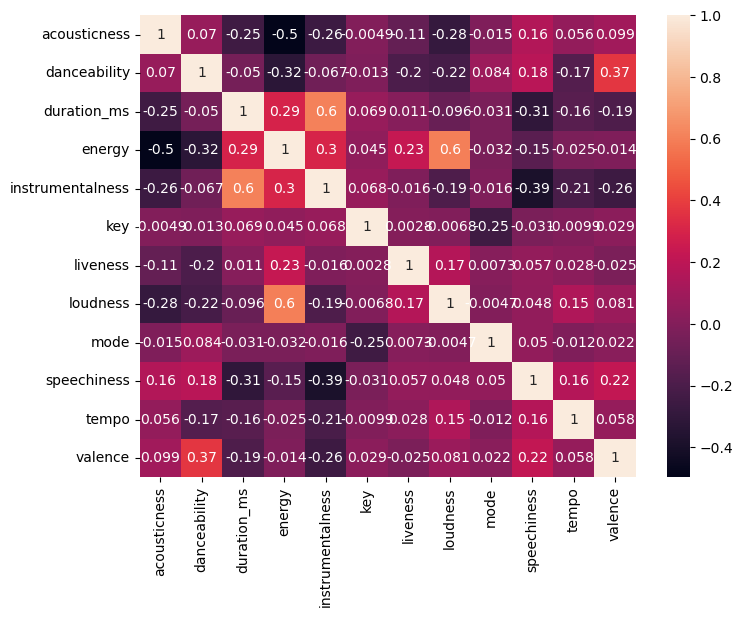

In [25]:
plt.figure(figsize=(8, 6))
sns.heatmap(X.corr(), annot=True)
plt.show()

No variable has a strong correlation with others. We will retain all specifications.<br>
We separate our data into training and test data.<br>
Since large values would have a much larger impact but are not necessarily more important for gender prediction than covariates with a smaller range of values, we normalize our training data,<br> so all features have a mean = 0 and a standard deviation = 1

### <a style="color: blue" class="anchor" id="sub_section_5_4_2"> PCA for dimentionnality reduction </a>


In [26]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, stratify=y ,random_state=7)

scaler = StandardScaler()

X_train = scaler.fit_transform(X_train)
X_test = scaler.fit_transform(X_test)

# Créer un dataframe à partir des données PCA
def affichage_3d(X_train, y_train) : 

  pca = PCA(n_components=3)
  data_pca = pca.fit_transform(X_train)

  df = pd.DataFrame(data_pca, columns=['x', 'y', 'z'])
  df['label'] = y_train

  fig = px.scatter_3d(df, x='x', y='y', z='z', color='label')
  fig.show()

affichage_3d(X_train, y_train)

Here is the data represented using PCA with n_components = 3, we notice that the data is not grouped perfectly but nevertheless we can notice some groupings which is a good sign

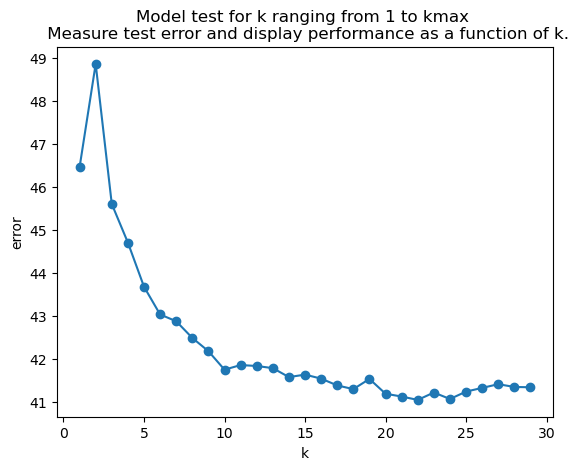

22


In [27]:
from sklearn import neighbors

def erreur(kmax, xtrain, xtest, ytrain, ytest):
    fig = plt.figure()
    errors = []
    errormin = 100
    kmin = 0

    for k in range(1,kmax):
      #Define the number of neighbor of k which will be used for the classifier
      knn = neighbors.KNeighborsClassifier(k)
      #Train the classifier and measure the test error
      error = 100*(1 - knn.fit(xtrain, ytrain).score(xtest, ytest))
      errors.append(error)
      if error < errormin :
        errormin = error
        kmin = k

    plt.title("Model test for k ranging from 1 to kmax \n Measure test error and display performance as a function of k.")
    plt.xlabel('k')
    plt.ylabel('error')

    plt.plot(range(1,kmax), errors, 'o-')

    plt.show()
    
    return kmin

print(erreur(30, X_train, X_test, y_train, y_test))

### So let's take k = 22 since its error is the lowest

### <a style="color: blue" class="anchor" id="sub_section_5_4_3">train the model</a>

In [28]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import HistGradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB


def precision(X_train, X_test, y_train, y_test) :
  model = DecisionTreeClassifier(random_state=10)
  model.fit(X_train, y_train)
  y_pred = model.predict(X_test)

  decisionTree = accuracy_score(y_test, y_pred)

  model = RandomForestClassifier(random_state  = 0)
  model.fit(X_train, y_train)
  y_pred = model.predict(X_test)

  randomForest = accuracy_score(y_test, y_pred)

  model = LogisticRegression(multi_class = 'ovr')
  model.fit(X_train,y_train)
  y_pred = model.predict(X_test)

  logisticRegression = accuracy_score(y_test, y_pred)

  model = GaussianNB()
  model.fit(X_train,y_train)
  y_pred = model.predict(X_test)

  naiveBayes = accuracy_score(y_test, y_pred)

  model = neighbors.KNeighborsClassifier(22)
  model.fit(X_train,y_train)
  y_pred = model.predict(X_test)

  knn = accuracy_score(y_test, y_pred)

  model = HistGradientBoostingClassifier(max_iter=500)
  model.fit(X_train,y_train)
  y_pred = model.predict(X_test)

  gradientBoosting = accuracy_score(y_test, y_pred)

  print("precision, decisionTree : ", decisionTree)
  print("precision, randomForest : ", randomForest)
  print("precision, logisticRegression : ", logisticRegression)
  print("precision, naiveBayes : ", naiveBayes)
  print("precision, Knn : ", knn)
  print("precision, gradientBoosting : ", gradientBoosting)

  
  
precision(X_train, X_test, y_train, y_test)

precision, decisionTree :  0.5512499104648664
precision, randomForest :  0.6548241529976363
precision, logisticRegression :  0.5679392593653749
precision, naiveBayes :  0.60396819712055
precision, Knn :  0.5894276914261156
precision, gradientBoosting :  0.6657116252417449


The gradient boosting algorithm has the highest score therefore it will be used to predict music genres. We add the predicted genres in our data frame

### <a style="color: blue" class="anchor" id="sub_section_5_4_4"> apply the model on the original data to add gennre column </a>

In [29]:
model = HistGradientBoostingClassifier(max_iter=500).fit(X.to_numpy(), y)
y_pred = model.predict(df1.to_numpy())

In [30]:
genres = []
genres_str = ['Dark Trap', 'Emo', 'Hiphop', 'Pop', 'Rap', 'RnB', 'Trap Metal', 
              'Underground Rap', 'dnb', 'hardstyle', 'psytrance', 
              'techhouse', 'techno', 'trance', 'trap']
for i in y_pred :
  genres.append(genres_str[i])

data['genres'] = genres

In [31]:
data2 = data.copy()

## <a style="color: green" class="anchor" id="section_5_5">understanding the "genre" column </a>
to well understand the relation between the different types of music we will try to apply "PCA/TSNE" and clustering techniques

### <a style="color: blue" class="anchor" id="sub_section_5_5_1">clustering and visualising the data by PCA

In [36]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=False))
                                 ], verbose=False)

X = data2.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data2['cluster_label'] = song_cluster_labels

In [39]:
data

,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,valence,popularity,year,hitfactor,genres
0,0.9950,0.708,158648,0.1950,0.563000,10,0.1510,-12.428,1,0.0506,118.469,0.7790,0,1928,-0.961171,Hiphop
1,0.9940,0.379,282133,0.0135,0.901000,8,0.0763,-28.454,1,0.0462,83.972,0.0767,0,1928,-0.130385,Dark Trap
2,0.6040,0.749,104300,0.2200,0.000000,5,0.1190,-19.924,0,0.9290,107.177,0.8800,0,1928,-0.000000,Underground Rap
3,0.9950,0.781,180760,0.1300,0.887000,1,0.1110,-14.734,0,0.0926,108.003,0.7200,0,1928,-1.320267,Emo
4,0.9900,0.210,687733,0.2040,0.908000,11,0.0980,-16.829,1,0.0424,62.149,0.0693,1,1928,-0.648080,Emo
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
169904,0.1730,0.875,163800,0.4430,0.000032,1,0.0891,-7.461,1,0.1430,100.012,0.3060,75,2020,-0.000016,Rap
169905,0.0167,0.719,167468,0.3850,0.031300,8,0.1110,-10.907,1,0.0403,128.000,0.2700,64,2020,-0.001578,Dark Trap
169906,0.5380,0.514,180700,0.5390,0.002330,7,0.1080,-9.332,1,0.1050,123.700,0.1530,70,2020,-0.003241,Dark Trap
169907,0.0714,0.646,167308,0.7610,0.000000,1,0.2220,-2.557,1,0.0385,129.916,0.4720,70,2020,-0.000000,Underground Rap


In [42]:
from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
cluster_data = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=cluster_data)
projection['title'] = data2['genres']
projection['cluster'] = data2['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

We can see clearly some cluster have been created based on the genre 

### <a style="color: blue" class="anchor" id="sub_section_5_5_2"> linear regression between year and popularity </a>

Residuals linear model = [17754133.4224016]
R test linear model = 0.7756750538901573


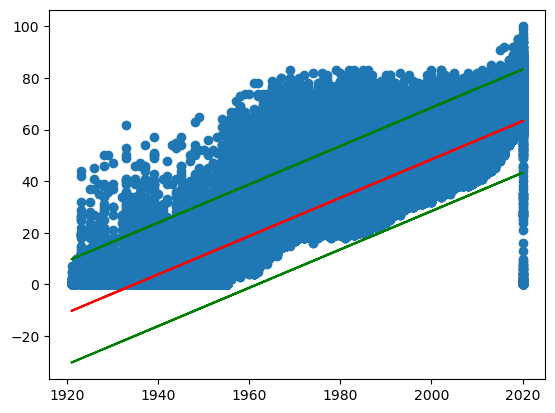

In [43]:
x = np.asarray(data2['year']).reshape(-1, 1)
y = np.asarray(data2['popularity']).reshape(-1, 1)

model = LinearRegression()
model.fit(x,y)
y_pred = model.predict(x)

print('Residuals linear model = ' + str(model._residues.flatten()))
print('R test linear model = ' + str(model.score(x,y)))


sum_errs = np.sum((y - y_pred)**2)
stdev = np.sqrt(1/(len(y)-2) * sum_errs)
interval = 1.96 * stdev
lower, upper = y_pred - interval, y_pred + interval


plt.scatter(x,y)
plt.plot(x,y_pred,c = "r")
plt.plot(x,lower,c = "g")
plt.plot(x,upper,c = "g")
plt.show()

## <a style="color: green" class="anchor" id="section_5_6"> what caracteristics have every genre </a>

In [44]:
#groupping the data by years(100 years : 1921-2021)
genre_data = data2.groupby('genres').mean()

#make a copy of the index(genres) because it is not accessible as a column
genre_data['genre']= genre_data.index
#we will use (index_column) as (genre)

#change the type of the year to int 
genre_data['year'] = genre_data['year'].astype(int)

#change the type of the popularity to int 
genre_data['popularity'] = genre_data['popularity'].astype(int)

In [45]:
fig = px.bar(genre_data, x='genre', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')
fig.show()
fig = px.bar(genre_data, x='genre', y=['loudness'], barmode='group')
fig.show()

## <a style="color: green" class="anchor" id="section_5_7">what "genre" was popular in the thirties</a>

In [46]:
thirties_data = data2[(data2.year >1929) & (data2.year <1940)]
thirties_data.reset_index(inplace=True)

In [47]:
thirties_genres = thirties_data['genres'].value_counts().head(10)
thirties_genres
fig = px.pie(thirties_genres, values=thirties_genres.values, names=thirties_genres.index, title='popular genres in the 30s')
fig.show()

## <a style="color: green" class="anchor" id="section_5_8">Conclusion 2</a>
the most popular "genre" of music in the thirties was "hiphop / rap" and as we can see in the previous plots<br>
the "enery" & "loudness" in the "Hiphop" type is very low <br>
and we did see in the table of correlations that there is a strong positive correlation between "energy/popularity" and "loudness/popularity"
that explain why the hitfactor was going so much down : (because people were listening to "hiphop / hip " to much and nearly nothing else. and because of the caractiristics of "hiphop / rap" (very low energy and loudness) the hitfactor goes so much down (and not the popularity)

# some additional meaningful plots  <a class="anchor" id="chapter5"></a> <br>
Now that we answered all the question we wanted to answer with this study  <br> we will now try to give some meaningful information and plots about this dataset

## <a style="color: green" class="anchor" id="section_6_1">How many song there is for every genre </a>

In [48]:
genres = data2['genres'].value_counts()
fig = px.pie(genres, values=genres.values, names=genres.index, title='songs per genres')
fig.show()

## <a style="color: green" class="anchor" id="section_6_2">popularity of every genre</a>

In [49]:
fig = px.pie(genre_data, values=genre_data['popularity'], names=genre_data['genre'].index, title='popularity per genre')
fig.show()